# Real Gas Radiation

This notebook describes the [real gas radiation model](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/Model/radiation/real_gas.py) and goes through some examples of things that can be done with it.

# Model Description
## Flux equations
The difference between this model and the grey gas model is that now the optical depth depends on frequency (or wavenumber $\nu$ here). To derive the model flux equations in this case, we start with equations $(17)$ and $(18)$ from the [grey_radiation notebook](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/grey_radiation.ipynb):

\begin{equation}
\frac{dF^{\uparrow}_{\nu}}{d\tau_{\nu}} = F^{\uparrow}_{\nu} - \pi B(\nu, T)
\label{eq: 1}\tag{1}
\end{equation}

\begin{equation}
\frac{dF^{\downarrow}_{\nu}}{d\tau_{\nu}} = -F^{\downarrow}_{\nu} + \pi B(\nu, T)
\label{eq: 2}\tag{2}
\end{equation}

where:

\begin{equation}
d\tau_{\nu} = -\rho kdz = \frac{k}{g}dp
\label{eq: 3}\tag{3}
\end{equation}

using the hydrostatic equation $\partial p/\partial z = - g\rho$. $k = \sum_{i=0}^n k_iq_i$ where $q_i(z)$ is the specific humidity ($q_i = \rho_i / \rho$). $k_i$ is an absorption coefficient and has units of area per unit mass ($m^2kg^{-1}$). $i$ refers to a particular molecule, $k_i$ depends on wavenumber $\nu$ and pressure $p$ whereas $q_i$ just depends on pressure. Note $\tau_{\nu}$ increases towards the surface and is $0$ at the top of the atmosphere where $p=0$. $B(\nu, T)$ is the blackbody distribution.

By combining the homogenous and particular solutions, the solution to $(1)$ is:


\begin{equation}
F^{\uparrow}_{\nu}(\tau_{\nu}) = F^{\uparrow}_{\nu}(\tau_{\nu}^s)e^{\tau_{\nu} - \tau_{\nu}^s} + 
\int_{\tau_{\nu}}^{\tau_{\nu}^s} \pi B(\nu, T) e^{\tau_{\nu} - \tau_{\nu}'} d\tau_{\nu}'
\label{eq: 4}\tag{4}
\end{equation}

where $\tau_{\nu}^s$ is the optical depth at the surface for wavenumber $\nu$ and we assume [we know the surface flux value](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/Model/radiation/real_gas.py#L568-L569) $F^{\uparrow}_{\nu}(\tau_{\nu}^s)$, i.e. blackbody spectrum of planet surface.

If we then define the [transmission function](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/Model/radiation/real_gas.py#L106-L130) over a wavenumber interval $\Delta \nu$ as a function of two pressures $p_1$ and $p_2$ to be:

\begin{equation}
\mathcal{T}_{\Delta \nu}(p_1, p_2) = \frac{1}{\Delta \nu} \int_{\Delta \nu} e^{\tau_{\nu}(p_1) - \tau_{\nu}(p_2)} d\nu
\label{eq: 5}\tag{5}
\end{equation}

We can then integrate $(4)$ over wavenumber and convert the $\tau$ integral to a $p$ integral to give:

\begin{equation}
F^{\uparrow}_{\Delta \nu}(p) = \frac{1}{\Delta \nu} \int_{\Delta \nu} F^{\uparrow}_{\nu}(p) = F^{\uparrow}_{\nu}(p_s)\mathcal{T}_{\Delta \nu}(p, p_s) - \int_{p}^{p_s} \pi B(\nu, T(p')) \frac{d\mathcal{T}_{\Delta \nu}(p, p')}{dp'} dp'
\label{eq: 6}\tag{6}
\end{equation}

Doing the same for the downward flux, assuming [we know the top of atmosphere flux value](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/Model/radiation/real_gas.py#L570-L573) $F^{\downarrow}_{\nu}(0)$, i.e. blackbody spectrum of star, we get:

\begin{equation}
F^{\downarrow}_{\Delta \nu}(p) = F^{\downarrow}_{\nu}(0)\mathcal{T}_{\Delta \nu}(0, p) + 
\int_{0}^{p} \pi B(\nu, T(p')) \frac{d\mathcal{T}_{\Delta \nu}(p', p)}{dp'} dp'
\label{eq: 7}\tag{7}
\end{equation}

Summing over the wavenumber bands, we get the net flux:

\begin{equation}
F(p) = \sum_{\Delta \nu} \left(F^{\uparrow}_{\Delta \nu}(p) - F^{\downarrow}_{\Delta \nu}(p)\right)\Delta \nu
\label{eq: 8}\tag{8}
\end{equation}

We can then pass this flux into equation $(11)$ of the grey_radiation notebook to compute the evolution of temperature with time. Once the flux has been computed, the rest of the simulation is done in exactly the same way as in the grey gas case.

## Differences to grey model

### Optical depth
To compute the optical depth from real molecules, we need to know the absorption coefficient $k_i$ as a function of wavenumber and pressure. We get this data from [HITRAN](https://hitran.org/). We can get $k_i$ as a functio of pressure, temperature and wavenumber using the Line-by-line data. The functions in [```hitran.py```](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/Model/radiation/real_gas_data/hitran.py) then read in this data and [produce a lookup table](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/Model/radiation/real_gas_data/hitran.py#L306-L343) which contains $k_i(p, T, \nu)$ for the [requested set of pressures and temperatures](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/Model/radiation/real_gas_data/hitran.py#L35-L36). Chapter 4.4 of principles of planetary climate explains this process in more detail.

During a simulation, the absorption coefficients are [read in from these lookup tables](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/Model/radiation/real_gas.py#L87-L93). 

The absorption coefficients for $CO_2$, $CH_4$, $O_3$ and $H_2O$ are shown below for $T = 270K$ and surface pressure.

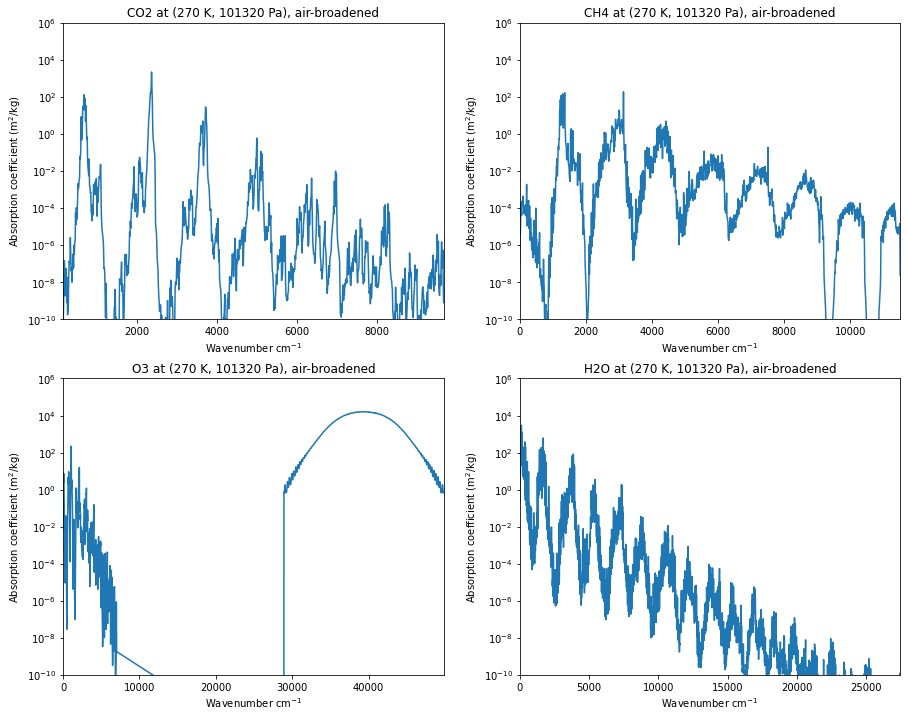

In [1]:
import warnings
warnings.filterwarnings("ignore") # ignore all warnings in this notebook
import matplotlib.pyplot as plt;
import Model.radiation.real_gas_data.hitran as hitran;
import Model.radiation.real_gas_data.specific_humidity as humidity;
import Model.radiation.real_gas_data.temperature_profiles as temp_prof;
from Model.radiation.real_gas import RealGas, transmission, B_wavenumber;
from Model.radiation.animation import Animate
from IPython.display import HTML;
import numpy as np

p_toa = 0.1  # Top of atmosphere pressure for this notebook (Pa)
fig, axs = plt.subplots(2,2, figsize=(15,12))
hitran.plot_absorption_coefficient('CO2', hitran.p_reference, 270, axs[0,0])
hitran.plot_absorption_coefficient('CH4', hitran.p_reference, 270, axs[0,1])
hitran.plot_absorption_coefficient('O3', hitran.p_reference, 270, axs[1,0])
hitran.plot_absorption_coefficient('H2O', hitran.p_reference, 270, axs[1,1])

To compute the optical depth, we also need the specific humidity distribution for each molecule, $q_i(p)$. To get these I [interporlate from the 2003 curve](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/Model/radiation/real_gas_data/specific_humidity.py) in the plots shown below, which come from a paper by [Stanley C. Solomon](https://agupubs.onlinelibrary.wiley.com/doi/full/10.1029/2019JA026678):

<img src="https://agupubs.onlinelibrary.wiley.com/cms/asset/bf9c83ca-c60b-40ff-a32f-97d8425691cc/jgra54943-fig-0001-m.jpg" width="700" height="200" />

These specific humidities are multiplied by the absorption coefficients and a [sum is performed over all molecules selected](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/Model/radiation/real_gas.py#L86-L95).

### Wavenumber bands
To obtain the fluxes from $(6)$ and $(8)$, [we assume](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/Model/radiation/real_gas.py#L516) that within the wavenumber band $\Delta \nu$, that the blackbody spectrum $B(\nu, T)$ is constant. So we must split choose the wavenumber bands in a way that this is roughly satisfied. This is done through the function [```get_wavenumber_bands.py```](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/Model/radiation/real_gas.py#L270-L336) which situates the desired number of bands (default is 40) so that the combined blackbody spectrum from the star and planet (these don't overlap except in the wavenumbers indicated by ```nu_overlap```) changes by about the same amount in each band. 

The function returns a dictionary containing the wavenumbers in a particular band, the central wavenumber (we then calculate $B(\nu, T)$ in each band using this), the wavenumber range and a quantity ```sw```. ```sw``` stands for short wave and it is ```True``` for a band if the wavenumber of that band is beyond the wavenumbers covered by the blackbody radiation of the planet. I.e. for these bands, $B_{planet}(\nu, T_g) = 0$ where $T_g$ is the ground temperature (we assume the ground temperature will be a good guess of the largest temperature encountered in the atmosphere) and so [we can neglect the integrals](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/Model/radiation/real_gas.py#L585-L587) in $(6)$ and $(7)$ for these bands. This is similar to the way I included short wave interaction in the grey radiation example.

### Ground Temperature
In this model, we assume we know the ground temperature, $T_g$ and [calculate the fluxes from it](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/Model/radiation/real_gas.py#L569). However usually, we won't know before hand the value of $T_g$ which will balance the incoming and outgoing fluxes at the top of the atmosphere. In these cases, an initial guess of the ground temperature is found using the function [```initial_Tg_guess```](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/Model/radiation/real_gas.py#L445-L465) which finds $T_g$ such that the sum of the initial net fluxes across all pressure levels is zero. 

A better estimate of $T_g$ can be found using the function [```find_Tg```](https://github.com/jduffield65/ClimateModel/blob/9fa1cdf7749cddd784c55ead8c3586de56c737ca/Model/radiation/real_gas.py#L467-L493) which runs the simulation to equilibrium with a number of different $T_g$ values. It then updates $T_g$ to the value which gives a net flux of approximately zero at the top of the atmosphere.

### Getting pressure grid
The [function to get the grid of pressure levels](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas.py#L349-L454) is different to the grey gas case. Here, [we define a relation](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas.py#L418-L424) between $k = \sum_{i=0}^n k_iq_i$ and the spacing of pressure levels in the grid. The larger the value of $k$, the smaller the spacing of pressure levels i.e. there are more grid points in regions where $k$ (which is proportional to the derivative of optical depth with respect to pressure) is large. This is the case if ```nz = 'auto'```. If ```nz``` is provided then the spacing of pressure levels is made smallest at the surface and increases towards the top of the atmosphere according to the function [$log(p_i) = log(p_s) + 1 - 10^{\alpha i}$](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas.py#L449) where $i$ represents the pressure level ($i$ = 0 is the surface and $i = n_z-1$ is the top of the atmosphere). $\alpha$ [can be derived](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas.py#L448) because we know what $p_0$ and $p_{n_z-1}$ must be.

# Evolution to Equilibrium

Much as with the grey gas example, lets initialise an atmosphere with a single temperature across the entire atmosphere and then evolve until we reach equilibrium. The [single temperature here](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas.py#L231) is the surface temperature $T_g$ not the isothermal temperature. 

The class to use is [```RealGas```](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas.py#L133-L243). At the very least, the number of y and z grid points must be supplied in addition to the [names of the molecules that are in the gas](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas.py#L144-L145) in a list e.g. ```['CO2', 'H2O']``` (These must match the names of the files in the absorption coefficient [LookupTable folder](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas_data/HitranData/LookupTables/CO2.npy)). If only this is supplied, the [default earth specific humidity data is used](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas.py#L205-L210) (stored in the ```molecules``` dictionary in the [```specific_humidity.py```](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas_data/specific_humidity.py#L171-L175) file.

One can also use their own profile by providing a dictionary [```q_funcs```](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas.py#L150-L153) where each key of the dictionary is a molecule name e.g. ```'CO2'``` and the corresponding value of the key is a function that takes pressure as its first argument and returns the specific humidity. The other arguments required for the function are provided by [```q_funcs_args```](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas.py#L154-L156) which is a dictionary with the same keys. 

Similarly, an initial temperature profile can be provided through [```T_func```](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas.py#L234) which is also a function with pressure as its first argument. Ground temperature can also be provided through [```T_g```](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas.py#L196-L203).

## $CO_2$
Lets start with an atmosphere containing only $CO_2$ with the [same specific humidity profile as Earth](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas_data/specific_humidity.py#L71-L91). First we need to find the surface temperature for this planet. This is done in the cell below. We use only 50 pressure levels to make it run quicker and we only need a rough result.

In the cell afterwards, we can initialise with the correct $T_g$ value and then find the equilibrium temperature profile, much as with the grey gas case.

In [2]:
# Find surface temperature
co2_atmos = RealGas(nz=50, ny=1, molecule_names=['CO2'], p_toa=p_toa, temp_change=1, delta_temp_change=0.5)
T_g_co2 = co2_atmos.find_Tg()

Finding ground temperature to give top of atmosphere flux balance...
Trying T_g = 258.8 K
Trying to reach equilibrium (flux_thresh = 0.1000)...
1 Years, 169 Days: delta_net_flux = 0.0997
Done!
Trying T_g = 258.9 K
Trying to reach equilibrium (flux_thresh = 0.0925)...
0 Years, 55 Days: delta_net_flux = 0.0905
Done!
Trying T_g = 256.3 K
Trying to reach equilibrium (flux_thresh = 0.0938)...
0 Years, 131 Days: delta_net_flux = 0.0917
Done!
Trying T_g = 264.7 K
Trying to reach equilibrium (flux_thresh = 0.0975)...
0 Years, 206 Days: delta_net_flux = 0.0741
Done!


In [3]:
T_g_co2 = 265.19  # answer to previous cell
co2_atmos = RealGas(nz='auto', ny=1, molecule_names=['CO2'], T_g=T_g_co2, p_toa=p_toa, temp_change=1, delta_temp_change=0.5)
flux_dict = {'lw_up': [], 'lw_down': [], 'sw_up': [], 'sw_down': []}
data_co2 = {'t': [], 'T': [], 'flux': flux_dict}
data_co2 = co2_atmos.save_data(data_co2, 0)
data_co2 = co2_atmos.evolve_to_equilibrium(data_co2, flux_thresh=1e-5, t_end=3.0) # run for at most 3 years

Trying to reach equilibrium (flux_thresh = 0.0000)...
3 Years, 1 Days: delta_net_flux = 0.018150
Done!


In [4]:
# get animation
anim_co2 = Animate(co2_atmos, data_co2['T'], data_co2['t'], flux_array=data_co2['flux'], nPlotFrames=70).anim; plt.close();
HTML(anim_co2.to_jshtml())

### Spectra

The animation shows that temperature decreases as pressure decreases, and we can get more insight for this by looking into the spectra. The first plot in the cell below shows the [outward longwave radiation](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas.py#L723-L744). This has a large chunk taken out of it at about $700cm^{-1}$ due to the large peak in the absorption coefficient there. Away from this peak though, pretty much all the radiation emitted by the surface escapes to space.

The second plot shows the amount of [solar radiation that reaches the surface](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas.py#L746-L769). Because $CO_2$ has no absorption features at these larger wavenumbers, all of the solar radiation reaches the surface.

### Transmission function

The third plot below shows the fraction of radiation emitted by the atmosphere at each pressure level reaches the top of the atmosphere for the most significant wavenumber bands. It clearly shows that all radiation emitted at pressure levels lower than 100 Pa reach the top of the atmosphere.

The fourth plot shows just how small the effect is on the solar radiation. In the strongest interacting short wave band, 99.2% of the solar radiation reaches the surface. 

In [5]:
def plot_transmission(atmos, band_indices, direction, combine=False, ax=None):
    if direction == 'up':
        p1 = atmos.p_interface[:1]
        p2 = atmos.p_interface
        title = 'Transmission to top of atmosphere'
    elif direction == 'down':
        p1 = atmos.p_interface
        p2 = atmos.p_interface[-1:]
        title = 'Transmission to surface'
    p_all = atmos.p_interface
    if ax is None:
        figure, ax = plt.subplots(1,1, figsize = (6, 6))
    for band_ind in band_indices:
        trans = transmission(p1, p2, p_all,
                             atmos.nu_bands['range'][band_ind], atmos.nu_bands['delta'][band_ind],
                             atmos.nu, atmos.tau_interface)
        plt.plot(trans.reshape(-1), atmos.p_interface, label = str(round(atmos.nu_bands['centre'][band_ind])))
    if combine:
        band_range = np.unique(np.concatenate([atmos.nu_bands['range'][i] for i in band_indices]))
        band_delta = band_range[-1] - band_range[0]
        band_centre = band_range[int(len(band_range)/2)]
        trans_combined = transmission(p1, p2, p_all, band_range, band_delta, atmos.nu, atmos.tau_interface)
        plt.plot(trans_combined.reshape(-1), atmos.p_interface, label = 'combined')
    ax.set_ylabel('Emitting pressure level / Pa')
    ax.set_xlabel('Transmission')
    ax.set_title(title)
    ax.set_yscale('log')
    ax.axes.invert_yaxis()
    ax.legend(title=r"$\nu / cm^{-1}$")

def plot_spectrum_and_transmission(atmos, band_indices, direction, combine=False):
    fig, axs = plt.subplots(1,3, figsize=(20,4))
    atmos.plot_olr(ax=axs[0])
    atmos.plot_incoming_short_wave(ax=axs[1])
    plot_transmission(atmos, band_indices, direction, combine, ax=axs[2])
    return axs
    

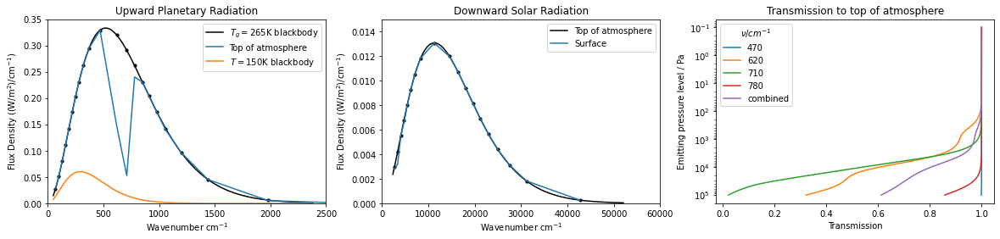

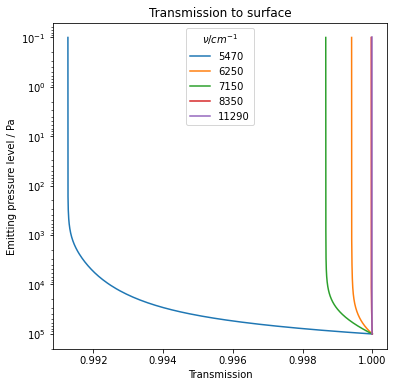

In [6]:
axs = plot_spectrum_and_transmission(co2_atmos, np.arange(10, 14), 'up', True);
axs[0].plot(co2_atmos.nu_lw, B_wavenumber(co2_atmos.nu_lw, 150)*np.pi, label='$T=150$K blackbody');
axs[0].legend();
plot_transmission(co2_atmos, np.array([25,26,27,28,29]), 'down', False);

### Neglecting short wave interaction

To investigate the lack of interaction with short wave radiation further, let us run the exact same simulation but cutting off the absorption coefficient at the end of the long wave regime ($\nu = 1500 cm^{-1}$). I.e. using the absorption coefficient shown below with the absorption coefficient zero at larger wavenumbers.

The final temperature profile plot shows that even neglecting this tiny interaction with solar radiation has quite a significant impact on the final profile. The profile is pretty much the same at pressures above $10^4 Pa$ but at altitudes above this, we can see that the interaction with the short wave radiation by $CO_2$ heats up the atmosphere.

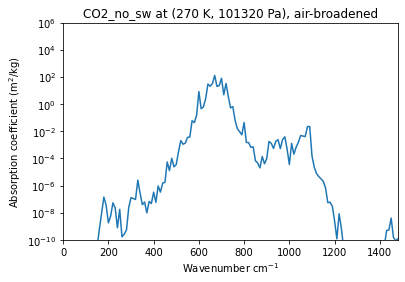

In [7]:
hitran.plot_absorption_coefficient('CO2_no_sw', hitran.p_reference, 270)

In [8]:
co2_lw_atmos = RealGas(nz='auto', ny=1, molecule_names=['CO2_no_sw'], T_g=T_g_co2, p_toa=p_toa, temp_change=1, delta_temp_change=0.5,
                   q_funcs={'CO2_no_sw': humidity.co2}, q_funcs_args={'CO2_no_sw': ()})
_ = co2_lw_atmos.evolve_to_equilibrium(flux_thresh=1e-5, t_end=3.0, save=False) # run for at most 3 years

Trying to reach equilibrium (flux_thresh = 0.0000)...
3 Years, 2 Days: delta_net_flux = 0.081644
Done!


In [9]:
def compare_temp_profile(atmospheres, labels, title):
    fig, ax = plt.subplots(1,1)
    for i in range(len(atmospheres)):
        ax.plot(atmospheres[i].T, atmospheres[i].p, label=labels[i]);
    ax.axes.invert_yaxis()
    ax.set_yscale('log')
    ax.legend();
    ax.set_ylabel('Pressure / Pa')
    ax.set_xlabel('Temperature / K')
    ax.set_title(title);
    return ax

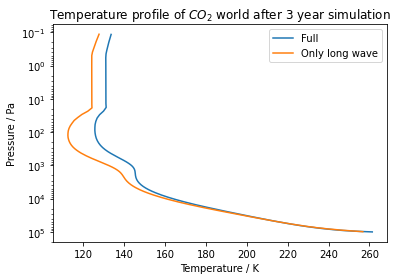

In [10]:
ax = compare_temp_profile([co2_atmos, co2_lw_atmos], ['Full', 'Only long wave'],
                          'Temperature profile of $CO_2$ world after 3 year simulation')

## $H_2O$

Lets do the same thing with a [water world](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas_data/specific_humidity.py#L121-L145). 

The ground temperature for a world with the same water vapour compositon as Earth but with no other gases has a surface temperature of around 300K, much warmer than the 265K for the pure $CO_2$ world. This is because there is much larger quantity of water vapour in the atmosphere than $CO_2$ as can be seen from the volume mixing ratio plots.

The simulation shown below doesn't quite reach equilibrium as the top of the atmosphere is stuck at its initial value and the lower altitudes are still cooling relatively quickly. However it shows a stratosphere where the temperature starts to increase again at pressures below $10^4 Pa$ and then a mesosphere when the temperature starts to decrease again above this. This is in contrast to the $CO_2$ world where the temperature basically just decreases as pressure decreases throughout the atmosphere.

Lets now look at the spectra.

In [11]:
# Find surface temperature
h2o_atmos = RealGas(nz=50, ny=1, molecule_names=['H2O'], p_toa=p_toa, temp_change=1, delta_temp_change=0.5)
T_g_h2o = h2o_atmos.find_Tg(print_eqb_info=False);

Finding ground temperature to give top of atmosphere flux balance...


In [12]:
T_g_h2o = 300 # answer to previous cell was 296.35
h2o_atmos = RealGas(nz='auto', ny=1, molecule_names=['H2O'], T_g=T_g_h2o, p_toa=p_toa, temp_change=1, delta_temp_change=0.1)
flux_dict = {'lw_up': [], 'lw_down': [], 'sw_up': [], 'sw_down': []}
data_h2o = {'t': [], 'T': [], 'flux': flux_dict}
data_h2o = h2o_atmos.save_data(data_h2o, 0)
data_h2o = h2o_atmos.evolve_to_equilibrium(data_h2o, flux_thresh=1e-3, t_end=0.7)

Trying to reach equilibrium (flux_thresh = 0.0010)...
0 Years, 256 Days: delta_net_flux = 0.0261
Done!


In [13]:
# get animation
anim_h2o = Animate(h2o_atmos, data_h2o['T'], data_h2o['t'], flux_array=data_h2o['flux'], nPlotFrames=70).anim; plt.close();
HTML(anim_h2o.to_jshtml())

### OLR

The first plot shows the outgoing long wave radiation, which shows a big chunk taken out of it at below about $\nu = 400 cm^{-1}$ and above  $\nu = 1500 cm^{-1}$. By looking at the transmission plot, we see that at these wavenumbers, almost none of the radiation emitting at altitudes below $p = 10^4 Pa$ reach the top of the atmosphere whereas basically all the radiation above it does. Hence at the top of the atmosphere, we see the spectrum expected from a blackbody with temperature equal to that of the atmosphere at $10^4 Pa$ i.e. about $140 K$. We see from the orange line that there is a good correspondence between the $140 K$ blackbody curve and the top of atmosphere spectrum.

This indicates that at these wavenumbers there is a saturation i.e. the transmission function is already zero at pressures above the threshold pressure of $3 \times 10^4 Pa$ so increasing $H_2O$ concentrations will not have any effect at these altitudes. It will just increase the height below which the transmission function is zero. Whereas for the $CO_2$ world above, for no wavenumbers is the transmission function zero so there is emission to space from all altitudes and increasing the $CO_2$ concentration would still affect all altitudes. This is why the blackbody spectrum at the temperature of $150 K$ corresponding to the emitting altitude of $10^3 Pa$ does not match the observed spectrum for $CO_2$ whereas the corresponding spectrum does match for $H_2O$.


### Incoming short wave radiation

From the absorption coefficient plots, it can be seen that $H_2O$ covers a much larger range of wavenumbers than $CO_2$. It infact encroaches into the spectral region of the stellar light. This explains why the short wave radiation reaching the surface is less than that at the top of the atmosphere, as shown in the flux plot of the animation.

This is shown more clearly by the second plot of the below cell, which plots the downward short wave radiation at the top of the atmosphere and at the surface. There is a discrepency between the top of atmosphere radiation and the radiation reaching the surface.
The fourth plot shows the fraction of radiation from the top of atmosphere that reaches the surface in the short wave bands where water is most strong. Clearly water has a significant effect and this is why we get a stratosphere/mesosphere structure even without the inclusion of ozone.

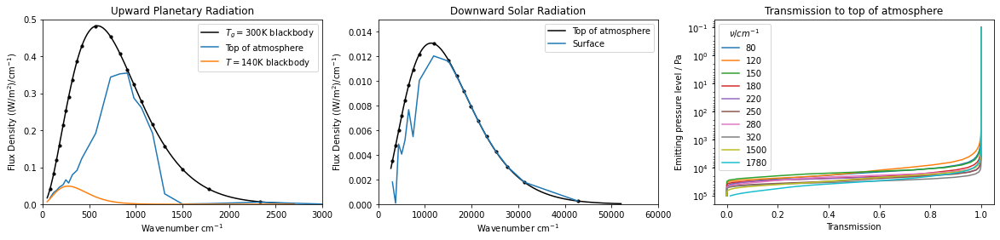

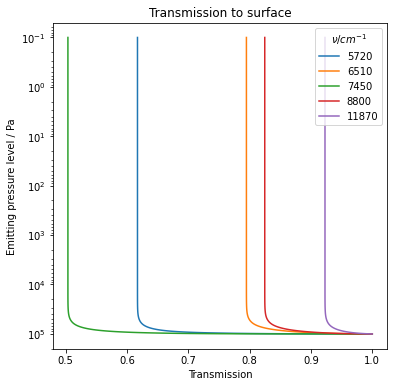

In [14]:
axs = plot_spectrum_and_transmission(h2o_atmos, np.concatenate((np.arange(8),np.arange(18, 20))), 'up', False)
axs[0].plot(h2o_atmos.nu_lw, B_wavenumber(h2o_atmos.nu_lw, 140)*np.pi, label='$T=140$K blackbody')
axs[0].legend();
plot_transmission(h2o_atmos, np.array([25,26,27,28,29]), 'down', False);

## Earth Atmosphere

Now we consider an atmosphere containing average earth humidity profiles for $H_2O$, $CO_2$, $CH_4$ and $O_3$. 

This world has a surface temperature of about $306 K$ which is slightly above the observed value of around $288 K$. The final profile of the animation has the broad features of the Earth's atmosphere. There is a troposphere below about $10000 Pa$ where the temperature decreases with altitude. There is a stratosphere above this, to about $20 Pa$, where the temperature increases with altitude due to high concentrations of ozone. Above this, to about $0.5 Pa$, there is a mesosphere, where the temperature decreases again due to the reduction in ozone concentration. Then above this, there is a thermosphere, where the temperature increases due to a second peak in ozone concentration. 

These features are at approximately the correct pressure values but the temperatures are a bit off. The tropopause temperature of $180 K$ is well below the observed value of around $215 K$. The stratopause temperature should be about $270 K$ and the mesopause temperature should be about $185 K$.

Also, if we decrease the top of atmosphere pressure used in the simulation, the temperature would start to decrease again as the ozone concentration does. I think the actually thermosphere temperature increase is due to nitrogen and oxygen atoms which are not in the model.

In [15]:
# Find surface temperature
earth_atmos = RealGas(nz=50, ny=1, molecule_names=['CO2', 'CH4', 'H2O', 'O3'], p_toa=p_toa, temp_change=1, delta_temp_change=0.5)
T_g_earth = earth_atmos.find_Tg(print_eqb_info=False);

Finding ground temperature to give top of atmosphere flux balance...


In [16]:
T_g_earth = 306.44 # answer to above cell
earth_atmos = RealGas(nz='auto', ny=1, molecule_names=['CO2', 'CH4', 'H2O', 'O3'],
                      T_g=T_g_earth, p_toa=0.1, temp_change=1, delta_temp_change=0.05)
flux_dict = {'lw_up': [], 'lw_down': [], 'sw_up': [], 'sw_down': []}
data_earth = {'t': [], 'T': [], 'flux': flux_dict}
data_earth = earth_atmos.save_data(data_earth, 0)
data_earth = earth_atmos.evolve_to_equilibrium(data_earth, flux_thresh=5e-3, t_end=2.0) # run for at most 3 years

Trying to reach equilibrium (flux_thresh = 0.0050)...
0 Years, 160 Days: delta_net_flux = 0.0049
Done!


In [17]:
# get animation
anim_earth = Animate(earth_atmos, data_earth['T'], data_earth['t'], flux_array=data_earth['flux'], nPlotFrames=100).anim; plt.close();
HTML(anim_earth.to_jshtml())

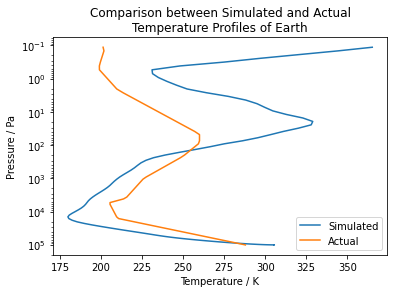

In [18]:
ax = compare_temp_profile([earth_atmos], ['Simulated'], 'Comparison between Simulated and Actual\nTemperature Profiles of Earth')
ax.plot(temp_prof.earth_temp(earth_atmos.p), earth_atmos.p, label='Actual')
ax.legend();

### OLR

In the OLR spectra below, you can see the absorption due to water below $\nu = 400 cm^{-1}$ and above $\nu = 1500 cm^{-1}$ aswell as the $CO_2$ peak at $\nu = 700 cm^{-1}$. The transmission plot shows typical functions for the water region (blue) and the $CO_2$ region (yellow), this more explicitly illustrates the saturation effect I mentioned when talking about the water world and again the tropopause black body spectrum ($180 K$) matches the observed spectrum in the water region well.

### Incoming short wave radiation
Comparing the second plot below to the second plot of the water world, there is much less short wave radiation that reaches the surface in this case. Initially we may think this is because of ozone, but the ozone absorption is most significant in the UV range at the very large wavenumbers of above $30000 cm^{-1}$. Also, looking at the fourth plot, this wavenumber regime is shown by the brown line with the different shape and it transmits more flux than in the water wavenumber regime of between $5000 cm^{-1}$ and $10000 cm^{-1}$. 

Comparing the first 5 lines in the fourth plot here to the just $H_2O$ world, the transmission is less here. If the difference is not due to ozone then it must be due to methane which has a significant absorption coefficient in this wavenumber range. 

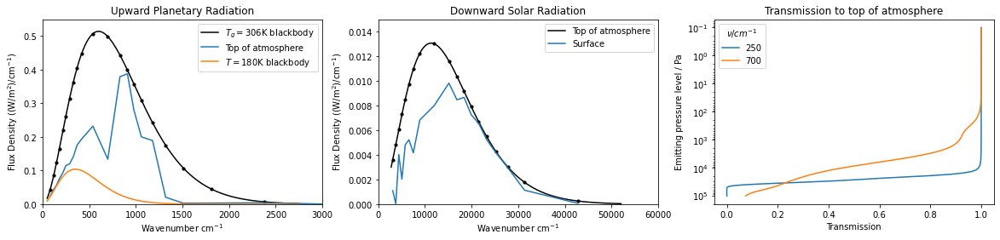

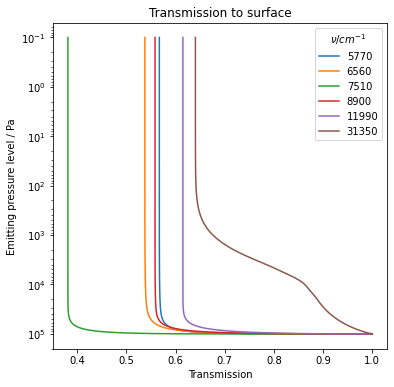

In [19]:
axs = plot_spectrum_and_transmission(earth_atmos, np.array([5, 11]), 'up', False)
axs[0].plot(earth_atmos.nu_lw, B_wavenumber(earth_atmos.nu_lw, 180)*np.pi, label='$T=180$K blackbody')
axs[0].legend();
plot_transmission(earth_atmos, np.array([25,26,27,28,29,38]), 'down', False);

### No Ozone

From the above discussion that the most obvious changes to the downward solar radiation spectrum are not due to ozone, we may wonder if ozone is actually that important?

The below cells evolve an atmosphere with no ozone for the same duration as with the earth atmosphere and with the same surface temperature. From this, we do see, as we expected, that the spectra look pretty much identical. However the temperature profile is significantly different. Clearly, ozone warms the upper atmosphere significantly but has little effect on the lower atmosphere (as there is very little ozone there).

Interestingly, the resulting temperature profile resembles that of the $CO_2$ world much more than the $H_2O$ world. This is probably because at high pressures, the $CO_2$ world and the $H_2O$ world look pretty similar and at pressures below $10^4 Pa$, there is much more $CO_2$ than $H_2O$.

In [20]:
no_ozone_atmos = RealGas(nz='auto', ny=1, molecule_names=['CO2', 'CH4', 'H2O'],
                      T_g=T_g_earth, p_toa=0.1, temp_change=1, delta_temp_change=0.05)
t_earth_end_years = data_earth['t'][-1]/365/24/60**2
_ = no_ozone_atmos.evolve_to_equilibrium(flux_thresh=5e-5, t_end=t_earth_end_years, save=False)

Trying to reach equilibrium (flux_thresh = 0.0001)...
0 Years, 160 Days: delta_net_flux = 0.0220
Done!


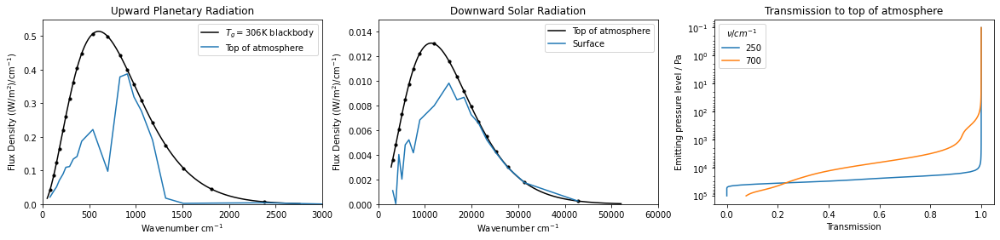

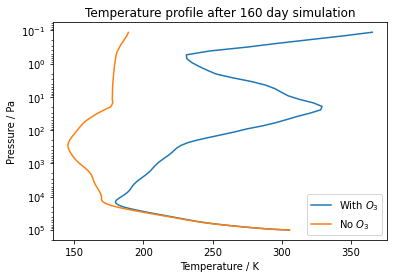

In [21]:
axs = plot_spectrum_and_transmission(no_ozone_atmos, np.array([5, 11]), 'up', False)
ax = compare_temp_profile([earth_atmos, no_ozone_atmos], ['With $O_3$', 'No $O_3$'],
                          'Temperature profile after ' + str(round(t_earth_end_years*365)) + ' day simulation')

## With convection

This next section just uses the same atmosphere as above (with $O_3$) but with the inclusion of convective adjustment. It doesn't appear to make much difference. The suface temperature is now slightly less but the structure of the atmosphere is exactly the same. Also, it seems equilibrium has not yet been reached because there is still a net flux near the surface.

In [22]:
# Find surface temperature
earth_atmos_conv = RealGas(nz=50, ny=1, molecule_names=['CO2', 'CH4', 'H2O', 'O3'], p_toa=p_toa, temp_change=1, delta_temp_change=0.5)
T_g_earth_conv = earth_atmos_conv.find_Tg(convective_adjust=True, print_eqb_info=False);

Finding ground temperature to give top of atmosphere flux balance...


In [23]:
# run to time above simulation reached
t_earth_end_years = data_earth['t'][-1]/365/24/60**2
T_g_earth_conv = 302.93 # answer to above cell actually was 305.93 but think too high
earth_atmos_conv = RealGas(nz='auto', ny=1, molecule_names=['CO2', 'CH4', 'H2O', 'O3'],
                      T_g=T_g_earth_conv, p_toa=0.1, temp_change=1, delta_temp_change=0.05)
_ = earth_atmos_conv.evolve_to_equilibrium(flux_thresh=5e-5, t_end=t_earth_end_years, convective_adjust=True, save=False)

Trying to reach equilibrium (flux_thresh = 0.0001)...
0 Years, 160 Days: delta_net_flux = 0.0045
Done!


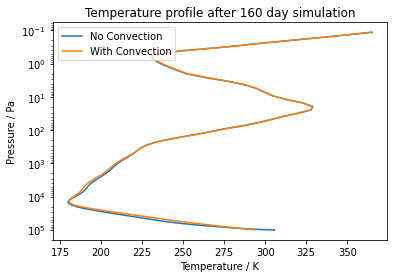

In [24]:
ax = compare_temp_profile([earth_atmos, earth_atmos_conv], ['No Convection', 'With Convection'],
                          'Temperature profile after ' + str(round(t_earth_end_years*365)) + ' day simulation')

# Changing Composition

As we did in the grey case, we can also see how the temperature evolves if we change the composition of the atmosphere. To do this, we use the function [```evolve_change_compos```](https://github.com/jduffield65/ClimateModel/blob/3688bc220a3049466a4cdf279d0ad2fbec3b8a44/Model/radiation/real_gas.py#L684-L721). This requires a sequence of ground temperatures and a sequence of specific humidity function arguments. It will then evolve to equilibrium at each then discontinuosly change the composition and ground temperature and then evolve to equilibrium again.

Thus first, we must find the correct ground temperatures for each of the specific humidity values we are using. This is what the first cell below cell does. In this example, we are only changing the $CO_2$ composition. The first composition is the typical earth value and the second multiplies this by a factor of 50. 

For this animation, we also include the concentration profiles (in ppmv).

In [25]:
# Evolving CO2 conc - finding list of ground temp eqb 
earth_atmos_change = RealGas(nz=50, ny=1, molecule_names=['CO2', 'CH4', 'H2O', 'O3'], temp_change=1, delta_temp_change=0.1)
n_conc_values = 2
q_args = [earth_atmos_change.q_funcs_args.copy()]
co2_multiplier = 50.0
T_g_earth_change = []
T_g_earth_change.append(earth_atmos_change.find_Tg())
for i in range(1, n_conc_values):
    q_args.append(earth_atmos_change.q_funcs_args.copy())
    q_args[i]['CO2'] = (list(q_args[i-1].copy()['CO2'])[0]*co2_multiplier, *q_args[i-1]['CO2'][1:])
    earth_atmos_change = RealGas(nz=50, ny=1, molecule_names=['CO2', 'CH4', 'H2O', 'O3'], temp_change=1, delta_temp_change=0.1,
                                 q_funcs_args=q_args[i])
    T_g_earth_change.append(earth_atmos_change.find_Tg(print_eqb_info=False));

Finding ground temperature to give top of atmosphere flux balance...
Trying T_g = 268.8 K
Trying to reach equilibrium (flux_thresh = 0.1000)...
2 Years, 36 Days: delta_net_flux = 0.09360
Done!
Trying T_g = 268.8 K
Trying to reach equilibrium (flux_thresh = 0.1000)...
0 Years, 16 Days: delta_net_flux = 0.0601
Done!
Trying T_g = 334.7 K
Trying to reach equilibrium (flux_thresh = 0.0263)...
2 Years, 267 Days: delta_net_flux = 0.0178
Done!
Trying T_g = 302.1 K
Trying to reach equilibrium (flux_thresh = 0.0468)...
2 Years, 206 Days: delta_net_flux = 0.0262
Done!
Trying T_g = 306.8 K
Trying to reach equilibrium (flux_thresh = 0.0327)...
1 Years, 346 Days: delta_net_flux = 0.0266
Done!
Trying T_g = 307.5 K
Trying to reach equilibrium (flux_thresh = 0.0292)...
1 Years, 110 Days: delta_net_flux = 0.0268
Done!
Finding ground temperature to give top of atmosphere flux balance...


In [26]:
# Evolving CO2 conc - finding evolution towards equilibrium with each CO2 concentration
T_g_earth_change = [306.44, 320.7] # answer to above cell
# get q_args with CO2 conc doubling at each iteration
earth_atmos_change = RealGas(nz='auto', ny=1, molecule_names=['CO2', 'CH4', 'H2O', 'O3'],
                      T_g=T_g_earth_change[0], p_toa=0.1, temp_change=1, delta_temp_change=0.05)
q_args = [earth_atmos_change.q_funcs_args.copy()]
n_conc_values = 2
co2_multiplier = 50.0
for i in range(1, n_conc_values):
    q_args.append(earth_atmos_change.q_funcs_args.copy())
    q_args[i]['CO2'] = (list(q_args[i-1].copy()['CO2'])[0]*co2_multiplier, *q_args[i-1]['CO2'][1:])

# get data
flux_dict = {'lw_up': [], 'lw_down': [], 'sw_up': [], 'sw_down': []}
q_dict = {'CO2': [], 'CH4': [], 'H2O': [], 'O3': []}
data_earth_atmos_change = {'t': [], 'T': [], 'flux': flux_dict, 'q': q_dict}
data_earth_atmos_change = earth_atmos_change.save_data(data_earth_atmos_change, 0)

data_earth_atmos_change = earth_atmos_change.evolve_change_compos(T_g_earth_change, q_args, data_earth_atmos_change,
                                                                  flux_thresh=5e-3, t_end=2.0)

Composition 1/2
Trying to reach equilibrium (flux_thresh = 0.0050)...
0 Years, 160 Days: delta_net_flux = 0.0049
Done!
Composition 2/2
Trying to reach equilibrium (flux_thresh = 0.0050)...
0 Years, 295 Days: delta_net_flux = 0.0049
Done!


In [27]:
anim_earth_change = Animate(earth_atmos_change, data_earth_atmos_change['T'], data_earth_atmos_change['t'],
                            flux_array=data_earth_atmos_change['flux'], q_array=data_earth_atmos_change['q'],
                            nPlotFrames=100).anim; plt.close();
HTML(anim_earth_change.to_jshtml())

### Transmission
The main effect after the $CO_2$ rise is that the upper atmosphere has cooled. This is because the cooling by the atmosphere itself is now more significant. I.e. the integral term in $(6)$ is more significant because the gradient of the transmission function with respect to pressure is non zero over a larger region of the atmosphere. For example, in the third plot below the gradient is zero above about $p = 10 Pa$ whereas with the typical earth $CO_2$ value, the gradient is zero above about $p = 100 Pa$. 

### Spectra

Comparing the spectra of the final atmosphere with 50x as much $CO_2$, with the 1 x $CO_2$ with no convection, we see that now transmission to the top of the atmosphere is less than 1 over a greater range of the atmosphere. The fact that $CO_2$ concentration is constant throughout the atmosphere means that the dependence of transmission with pressure is more gradual than in the water dominated bands and the transmission function is only zero right at the surface.

With this amount of $CO_2$, we have a second dip due to $CO_2$ due to the lesser peak in the absorption spectrum at about $1100 cm^{-1}$.

There is also a slight change to the downward solar radiation. The dip at around $6000 cm^{-1}$ now goes below about a flux density of 0.0005 whereas before, it only went as low as 0.002.

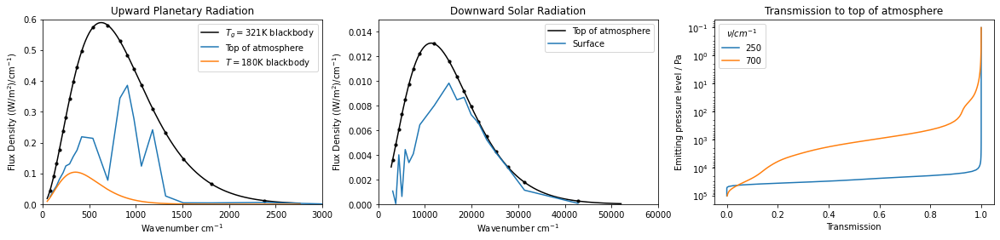

In [28]:
axs = plot_spectrum_and_transmission(earth_atmos_change, np.array([5, 11]), 'up', False)
axs[0].plot(earth_atmos_change.nu_lw, B_wavenumber(earth_atmos_change.nu_lw, 180)*np.pi, label='$T=180$K blackbody')
axs[0].legend();